In [ ]:
import os
import sys
import scipy.io
import scipy.misc
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
from PIL import Image
import numpy as np
import tensorflow as tf


Neural Style Transfer merges two images, namely: a "content" image (C) and a "style" image (S), to create a "generated" image (G). The generated image G combines the "content" of the image C with the "style" of image S.


Neural Style Transfer (NST) uses a previously trained convolutional network, and builds on top of that. The idea of using a network trained on a different task and applying it to a new task is called transfer learning.
Used VGG-19, a 19-layer version of the VGG network. This model has already been trained on the very large ImageNet database, and has learned to recognize a variety of low level features (at the shallower layers) and high level features (at the deeper layers).


In [ ]:
vgg = tf.keras.applications.VGG19(include_top=False,
                                  input_shape=(img_size, img_size, 3),
                                  weights='imagenet')

vgg.trainable = False



Building the Neural Style Transfer (NST) algorithm in three steps:

* 1) content cost function J_content(C,G)
* 2) style cost function J_style(S,G)
* 3) Total Cost J(G) = alpha *J_content(C,G) + beta *J_style(S,G)



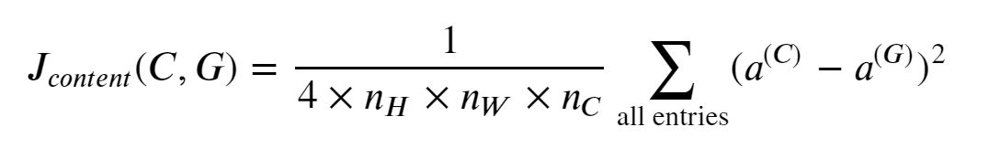

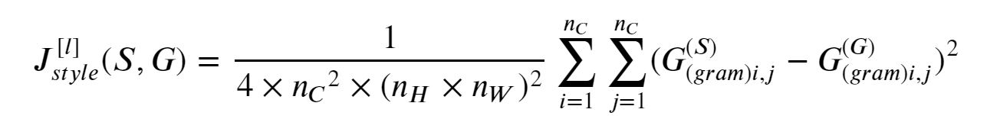


* The shallower layers of a ConvNet tend to detect lower-level features such as edges and simple textures.
* The deeper layers tend to detect higher-level features such as more complex textures and object classes.


We need the "generated" image G to have similar content as the input image C. Suppose you have chosen some layer's activations to represent the content of an image.
* will get the most visually pleasing results if you choose a layer from somewhere in the middle of the network--neither too shallow nor too deep. This ensures that the network detects both higher-level and lower-level features.

forward propagate image C,
* Set the image C as the input to the pretrained VGG network, and run forward propagation.  
* Let a^(C)(l) be the hidden layer activations in the layer l.  This will be an n_H x n_W x n_C tensor.

forward propagate image G,
* Repeat this process with the image G: Set G as the input, and run forward propagation.
* Let a^(G)(l) be the corresponding hidden layer activation.


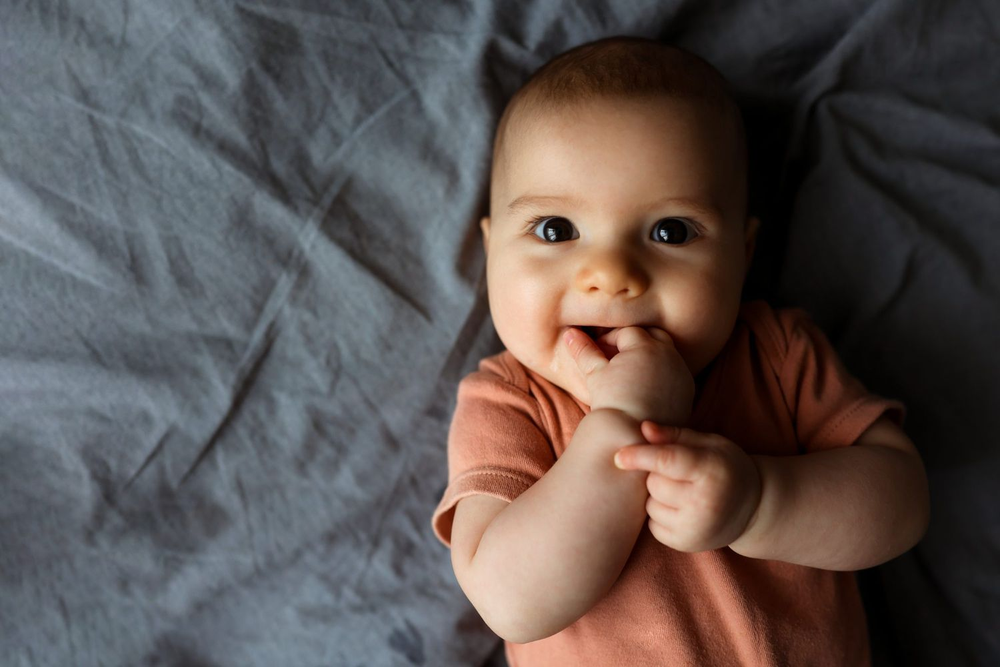

In [ ]:
content_image = Image.open("/content/baby.jpg")
content_image


In [ ]:
#function to compute Content Cost
def compute_content_cost(content_output, generated_output):
    """
    Computes the content cost

    Arguments:
    a_C -- tensor of dimension (1, n_H, n_W, n_C), hidden layer activations representing content of the image C
    a_G -- tensor of dimension (1, n_H, n_W, n_C), hidden layer activations representing content of the image G

    Returns:
    J_content -- scalar
    """
    a_C = content_output[-1]
    a_G = generated_output[-1]

    m, n_H, n_W, n_C = a_G.get_shape().as_list()

    # Reshape 'a_C' and 'a_G'
    a_C_unrolled = tf.reshape(a_C, shape=[m, n_H * n_W, n_C])
    a_G_unrolled = tf.reshape(a_G, shape=[m, n_H * n_W, n_C])

    J_content =  tf.reduce_sum(tf.square(a_C_unrolled - a_G_unrolled))/(4.0 * n_H * n_W * n_C)

    return J_content

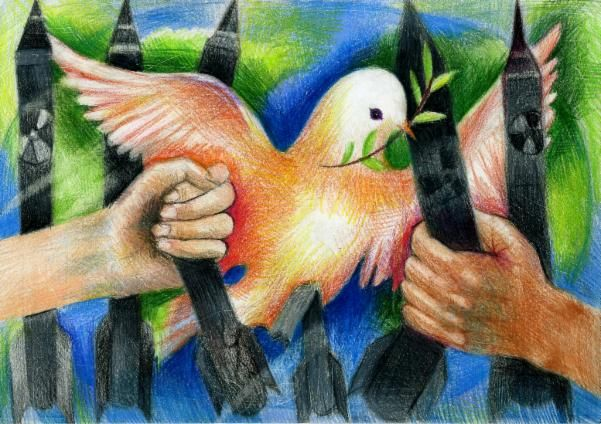

In [ ]:
example = Image.open("/content/Artwork.jpg")
example


Style Matrix/Gram matrix

* For the sake of clarity, in this assignment G_gram will be used to refer to the Gram matrix, and G to denote the generated image.

Computing Gram matrix G_gram by multiplying the "unrolled" filter matrix with its transpose:

G_gram = A_unrolled * A_unrolled^T



In [ ]:
#function to Compute Gram Matrix
def gram_matrix(A):
    """
    Argument:
    A -- matrix of shape (n_C, n_H*n_W)
    Returns:
    GA -- Gram matrix of A, of shape (n_C, n_C)
    """
    GA = tf.matmul(A, tf.transpose(A))
    return GA

In [ ]:
#function to compute layer style cost
def compute_layer_style_cost(a_S, a_G):
    """
    Arguments:
    a_S -- tensor of dimension (1, n_H, n_W, n_C), hidden layer activations representing style of the image S
    a_G -- tensor of dimension (1, n_H, n_W, n_C), hidden layer activations representing style of the image G

    Returns:
    J_style_layer
    """
    m, n_H, n_W, n_C = a_G.get_shape().as_list()

    # Reshape the tensors from (1, n_H, n_W, n_C) to (n_C, n_H * n_W)
    a_S = tf.transpose(tf.reshape(a_S, shape=[-1, n_C]))
    a_G = tf.transpose(tf.reshape(a_G, shape=[-1, n_C]))

    # Computing gram_matrices for both images S and G
    GS = gram_matrix(a_S)
    GG = gram_matrix(a_G)

    J_style_layer = tf.reduce_sum(tf.square(GS - GG))/(4.0 *(( n_H * n_W * n_C)**2))


    return J_style_layer

Style Weights

* better results if style costs from several different layers are merged.
* Each layer will be given weights, that reflect how much each layer will contribute to the style.


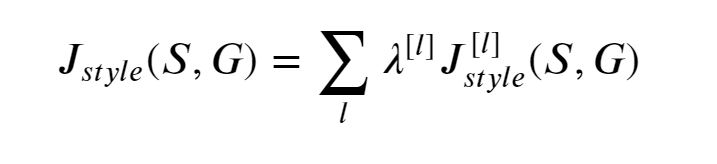

listing the layer names:

In [ ]:
for layer in vgg.layers:
    print(layer.name)

input_4
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


output of layer 'block5_conv4'.the content layer, which will represent the image.

In [ ]:
vgg.get_layer('block5_conv4').output

<KerasTensor: shape=(None, 25, 25, 512) dtype=float32 (created by layer 'block5_conv4')>

layers to represent the style of the image and assigning style costs:

In [ ]:
STYLE_LAYERS = [
    ('block1_conv1', 0.2),
    ('block2_conv1', 0.2),
    ('block3_conv1', 0.2),
    ('block4_conv1', 0.2),
    ('block5_conv1', 0.2)]

In [ ]:
#function to compute combined style cost

def compute_style_cost(style_image_output, generated_image_output, STYLE_LAYERS=STYLE_LAYERS):
    """
    Computes the overall style cost from several layers

    Arguments:
    style_image_output -- our tensorflow model
    generated_image_output --
    STYLE_LAYERS -- A python list containing:
                        - the names of the layers we would like to extract style from
                        - a coefficient for each of them

    Returns:
    J_style
    """


    J_style = 0

    # Set a_S to be the hidden layer activation from the layer we have selected.
    # The last element of the array contains the content layer image
    a_S = style_image_output[:-1]

    # Set a_G to be the output of the hidden layers.
    # The last element of the list contains the content layer image
    a_G = generated_image_output[:-1]
    for i, weight in zip(range(len(a_S)), STYLE_LAYERS):
        # Compute style_cost for the current layer
        J_style_layer = compute_layer_style_cost(a_S[i], a_G[i])

        # Add weight * J_style_layer of this layer to overall style cost
        J_style += weight[1] * J_style_layer

    return J_style

Total_cost


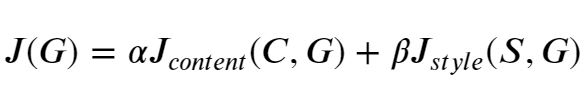

In [ ]:
#function to Compute Total Cost
@tf.function()
def total_cost(J_content, J_style, alpha = 10, beta = 40):
    """
    Arguments:
    J_content -- content cost coded above
    J_style -- style cost coded above
    alpha -- hyperparameter weighting the importance of the content cost
    beta -- hyperparameter weighting the importance of the style cost

    Returns:
    J -- total cost
    """
    J = alpha * J_content + beta * J_style

    return J

Load the Content Image and Resizing it to (400,400) and converting it to a tensor


(1, 400, 400, 3)


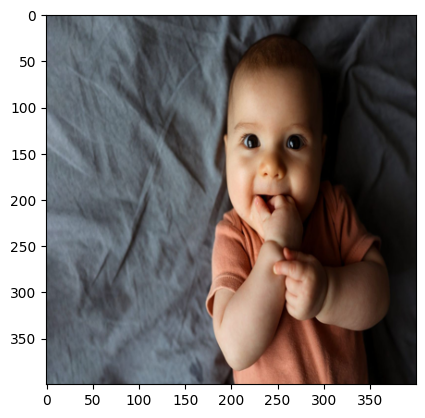

In [ ]:
content_image = np.array(Image.open("/content/baby.jpg").resize((400,400)))
content_image = tf.constant(np.reshape(content_image, ((1,) + content_image.shape)))

print(content_image.shape)
imshow(content_image[0])
plt.show()

Load the Style Image and resizing and converting it to a tensor


(1, 400, 400, 3)


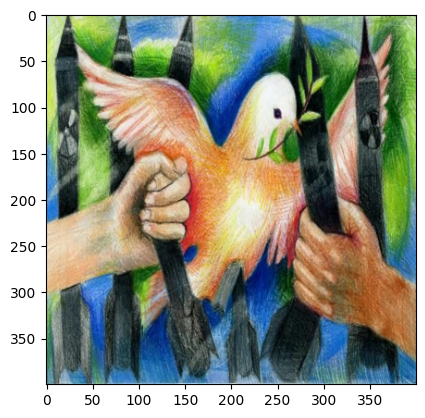

In [ ]:
style_image =  np.array(Image.open("/content/Artwork.jpg").resize((img_size, img_size)))
style_image = tf.constant(np.reshape(style_image, ((1,) + style_image.shape)))

print(style_image.shape)
imshow(style_image[0])
plt.show()

Randomly initialize the image to be Generated
* initializing the "generated" image as content_image.



<class 'tensorflow.python.ops.resource_variable_ops.ResourceVariable'>


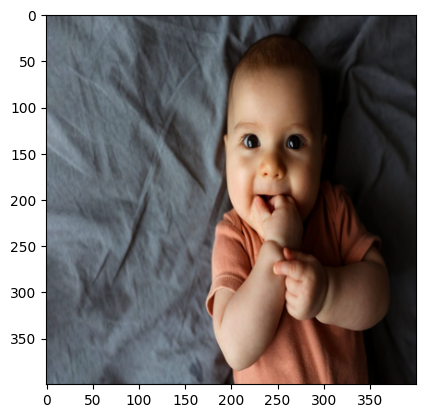

In [ ]:
generated_image = tf.Variable(tf.image.convert_image_dtype(content_image, tf.float32))
# noise = tf.random.uniform(tf.shape(generated_image), -0.25, 0.25)
# generated_image = tf.add(generated_image, noise)
# generated_image = tf.clip_by_value(generated_image, clip_value_min=0.0, clip_value_max=1.0)

print(type(generated_image))
imshow(generated_image.numpy()[0])
plt.show()

Loading Pre-trained VGG19 Model


In [ ]:
def get_layer_outputs(vgg, layer_names):
    """ Creates a vgg model that returns a list of intermediate output values."""
    outputs = [vgg.get_layer(layer[0]).output for layer in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model

defining the content layer and build the model.

In [ ]:
content_layer = [('block5_conv4', 1)]

vgg_model_outputs = get_layer_outputs(vgg, STYLE_LAYERS + content_layer)

In [ ]:
content_target = vgg_model_outputs(content_image)  # Content encoder
style_targets = vgg_model_outputs(style_image)     # Style encoder

Compute the Content image Encoding (a_C)


In [ ]:
# Assign the content image to be the input of the VGG model.
# Set a_C to be the hidden layer activation from the layer we have selected
preprocessed_content =  tf.Variable(tf.image.convert_image_dtype(content_image, tf.float32))
a_C = vgg_model_outputs(preprocessed_content)

 Compute the Style image Encoding (a_S)

The code below sets a_S to be the tensor giving the hidden layer activation for 'STYLE_LAYERS' using our style image.

In [ ]:
# Assign the input of the model to be the "style" image
preprocessed_style =  tf.Variable(tf.image.convert_image_dtype(style_image, tf.float32))
a_S = vgg_model_outputs(preprocessed_style)

In [ ]:
def clip_0_1(image):
    """
    Truncate all the pixels in the tensor to be between 0 and 1
    """
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

In [ ]:
def tensor_to_image(tensor):
    """
    Converts the given tensor into a PIL image
    """
    tensor = tensor * 255
    tensor = np.array(tensor, dtype=np.uint8)
    if np.ndim(tensor) > 3:
        assert tensor.shape[0] == 1
        tensor = tensor[0]
    return Image.fromarray(tensor)

Train_step

Implementing the train_step() function for transfer learning

* Using the Adam optimizer to minimize the total cost J.
* Using a learning rate of 0.01

* tf.GradientTape():
   * Computing the encoding of the generated image using vgg_model_outputs. Assign the result to a_G.
   * Computing the total cost J, using the global variables a_C, a_S and the local a_G
   * Using 'alpha = 10' and 'beta = 40'.

In [ ]:
print("TensorFlow version:", tf.__version__)

TensorFlow version: 2.14.0


In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
@tf.function()
def train_step(generated_image, alpha = 10, beta = 40):
    # generated_image = tf.Variable(initial_value=generated_image, trainable=True)
    with tf.GradientTape() as tape:
        tape.watch(generated_image)
        # Computing a_G as the vgg_model_outputs for the current generated image
        a_G = vgg_model_outputs(generated_image)
        J_style = compute_style_cost(a_S, a_G)
        # print(J_style.shape)
        J_content = compute_content_cost(a_C, a_G)
        # print(J_content.shape)
        # Computing the total cost
        J = total_cost(J_content, J_style,alpha = alpha, beta = beta)
        print(type(J),J.shape)
        # print(J.shape)


    grad = tape.gradient(J, generated_image)
    print(type(grad),grad.shape)
    print(type(generated_image),generated_image.shape)
    optimizer.apply_gradients([(grad, generated_image)])
    generated_image.assign(clip_0_1(generated_image))
    # return J

Training the Model


<class 'tensorflow.python.framework.ops.SymbolicTensor'> ()
<class 'tensorflow.python.framework.ops.SymbolicTensor'> (1, 400, 400, 3)
<class 'tensorflow.python.ops.resource_variable_ops.ResourceVariable'> (1, 400, 400, 3)
<class 'tensorflow.python.framework.ops.SymbolicTensor'> ()
<class 'tensorflow.python.framework.ops.SymbolicTensor'> (1, 400, 400, 3)
<class 'tensorflow.python.ops.resource_variable_ops.ResourceVariable'> (1, 400, 400, 3)
Epoch 0 


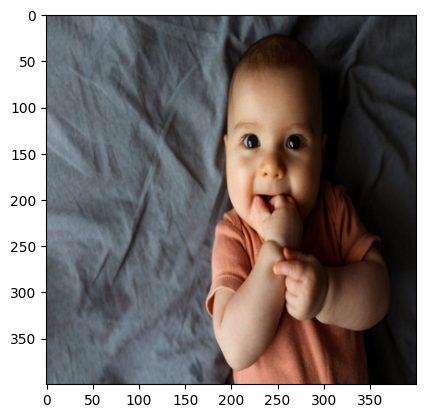

Epoch 500 


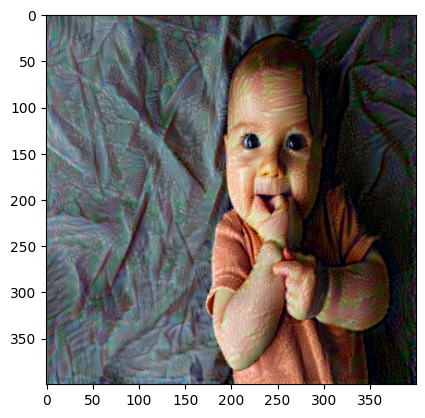

Epoch 1000 


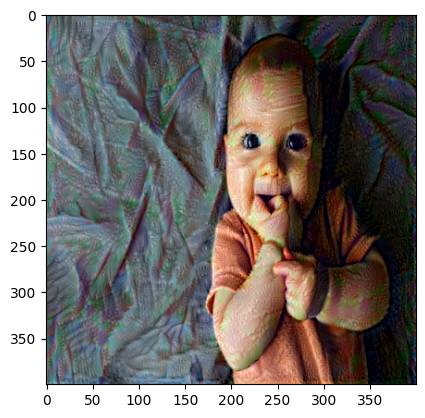

Epoch 1500 


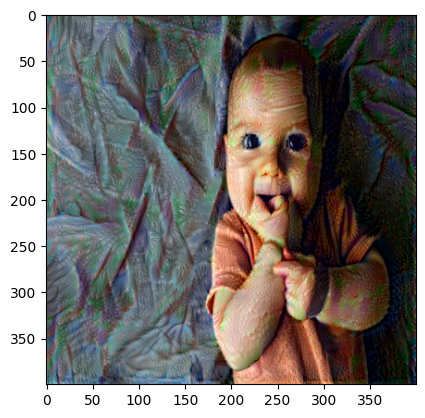

Epoch 2000 


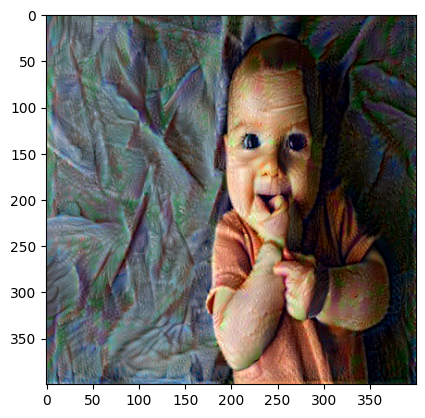

Epoch 2500 


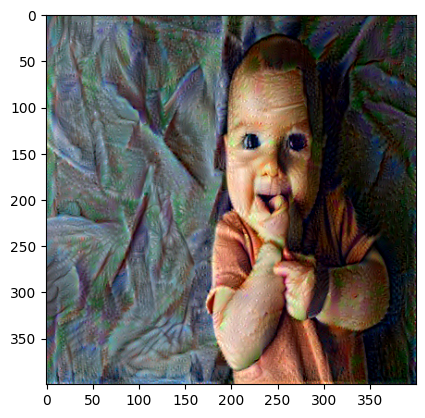

Epoch 3000 


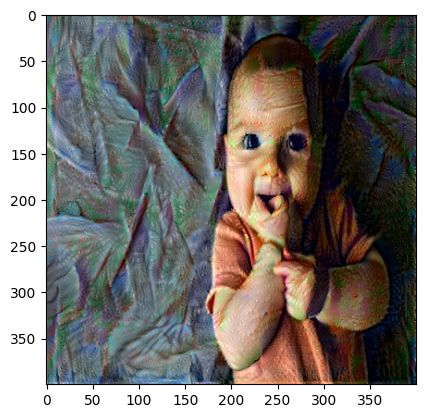

Epoch 3500 


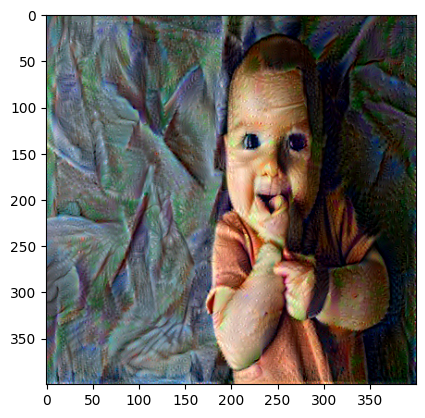

Epoch 4000 


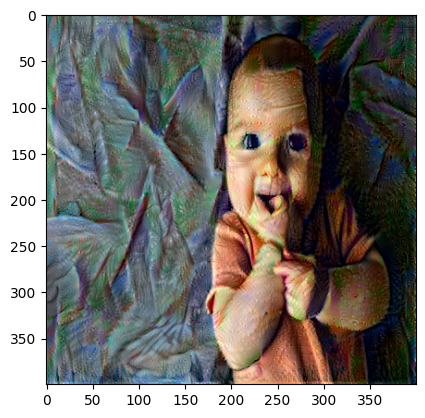

Epoch 4500 


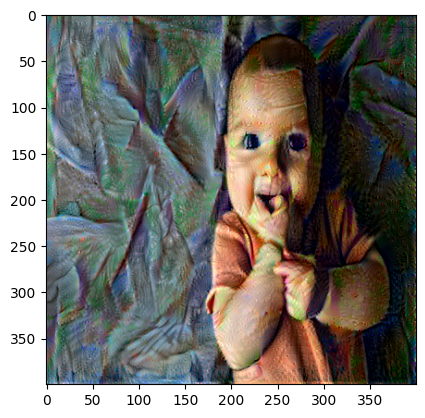

Epoch 5000 


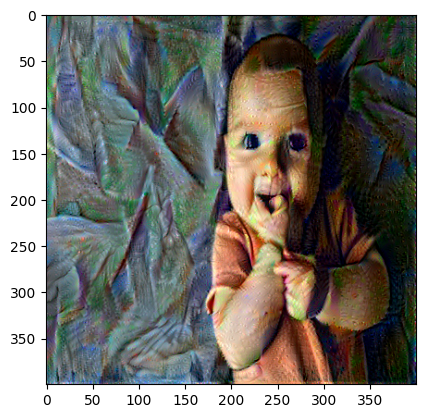

Epoch 5500 


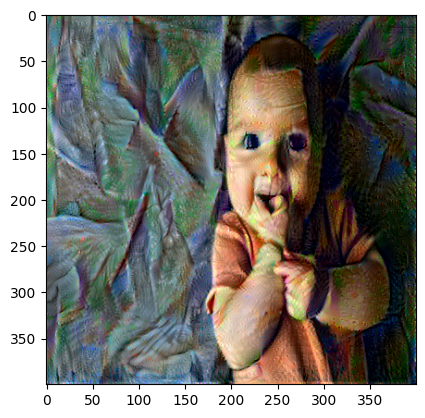

Epoch 6000 


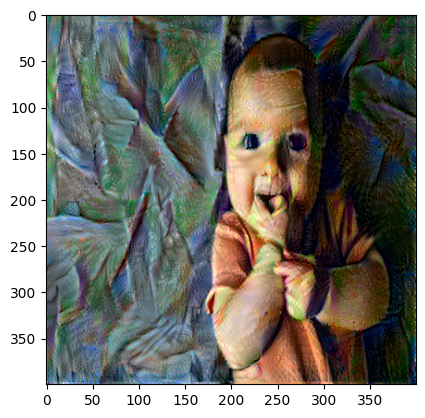

Epoch 6500 


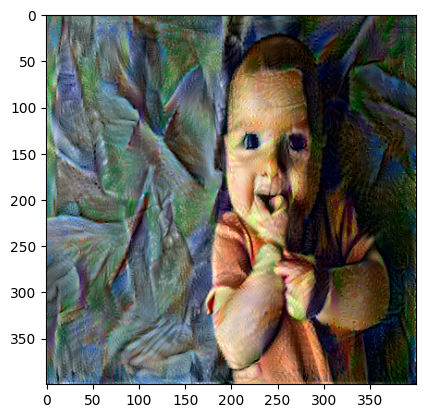

Epoch 7000 


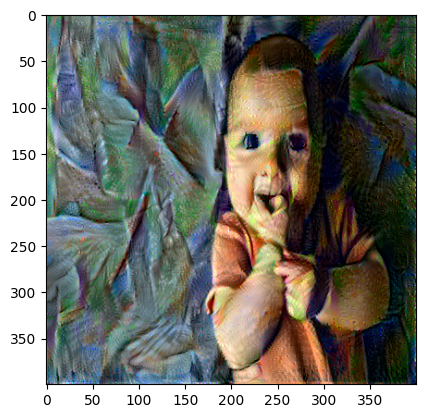

Epoch 7500 


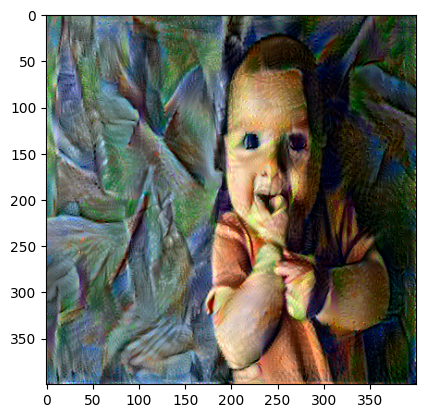

Epoch 8000 


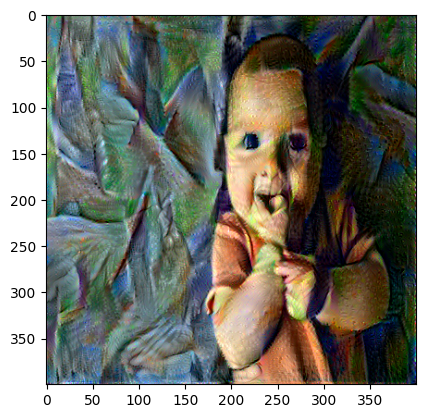

Epoch 8500 


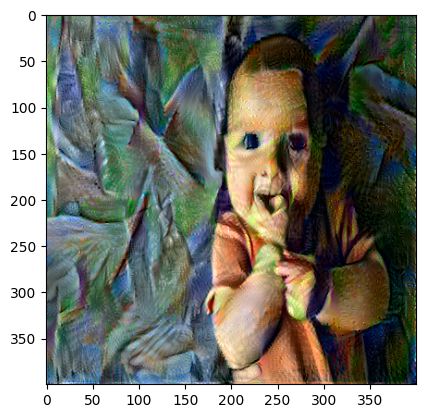

Epoch 9000 


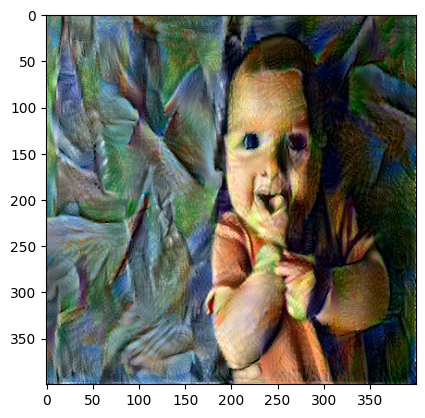

Epoch 9500 


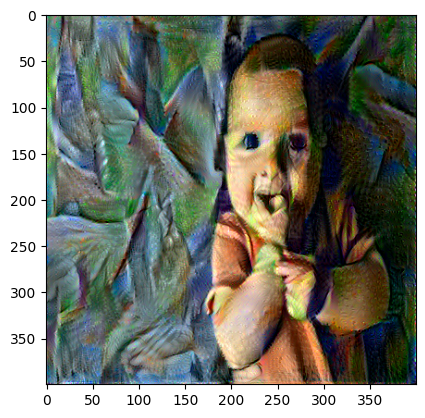

Epoch 10000 


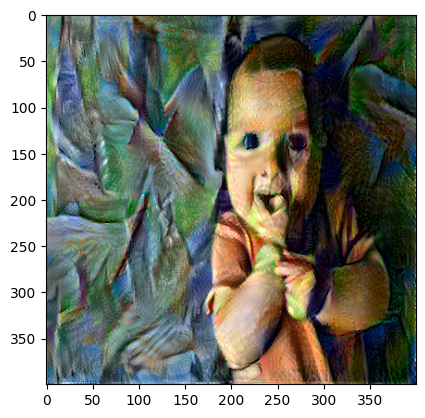

Epoch 10500 


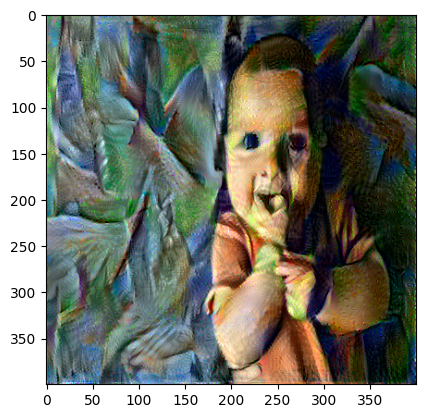

Epoch 11000 


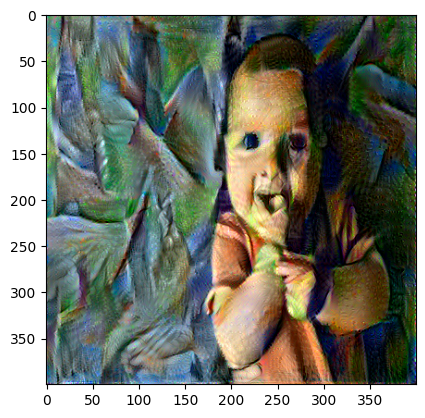

Epoch 11500 


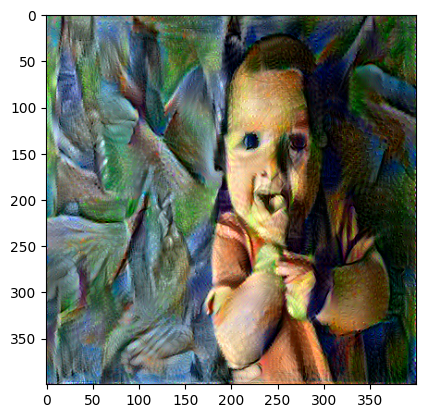

Epoch 12000 


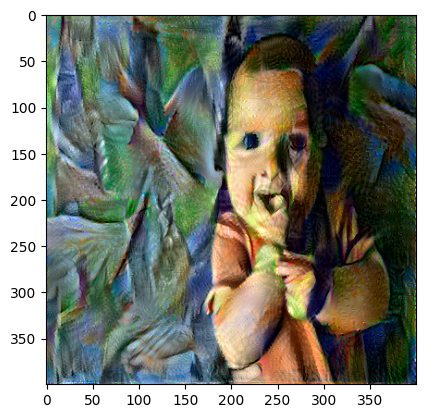

Epoch 12500 


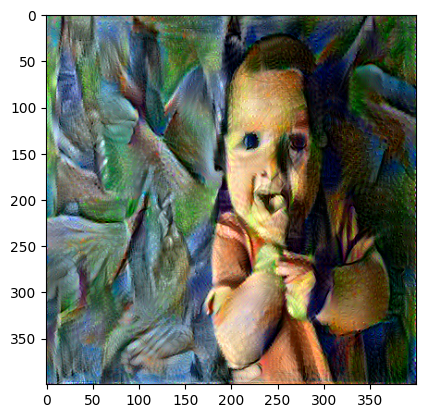

Epoch 13000 


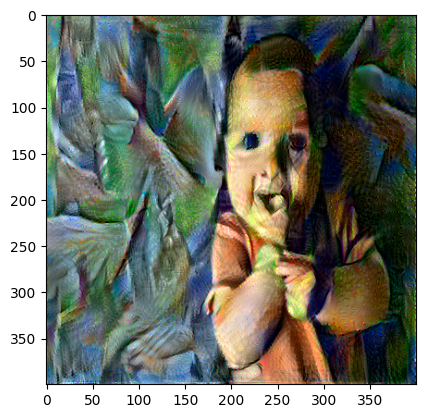

Epoch 13500 


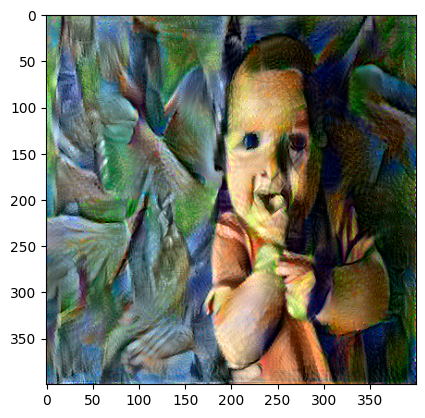

Epoch 14000 


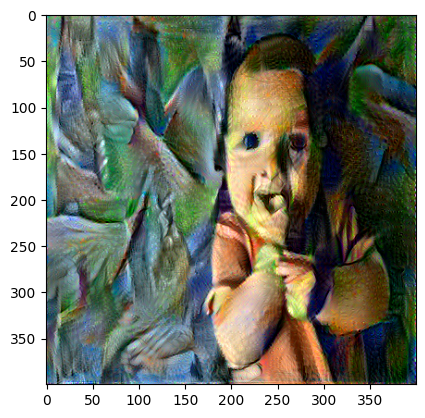

Epoch 14500 


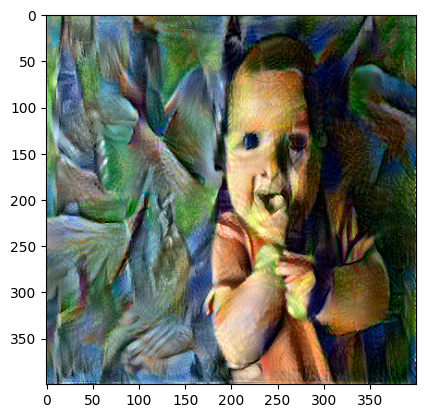

Epoch 15000 


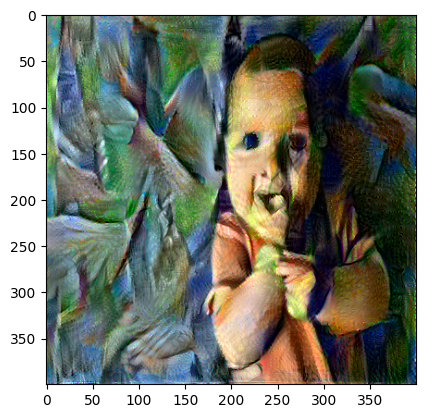

Epoch 15500 


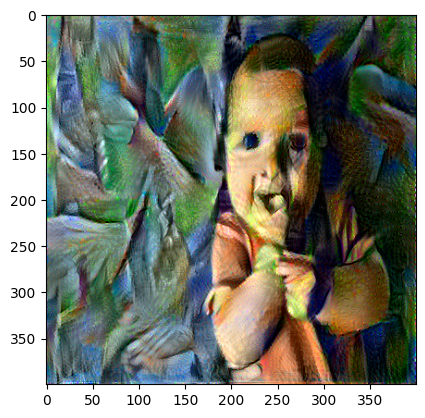

Epoch 16000 


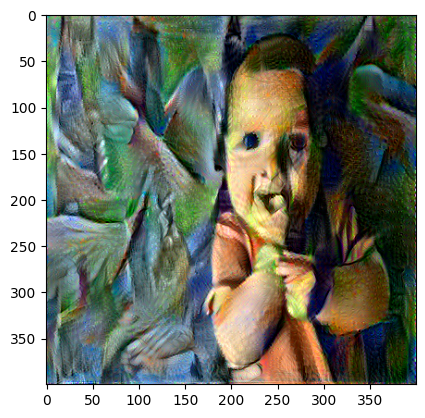

Epoch 16500 


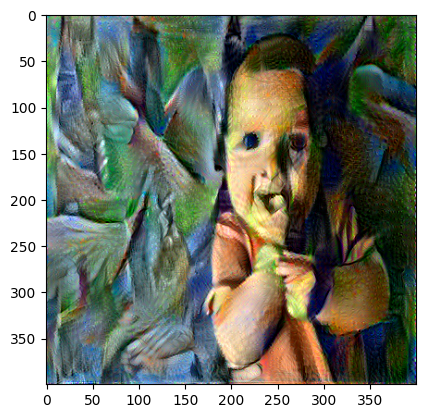

Epoch 17000 


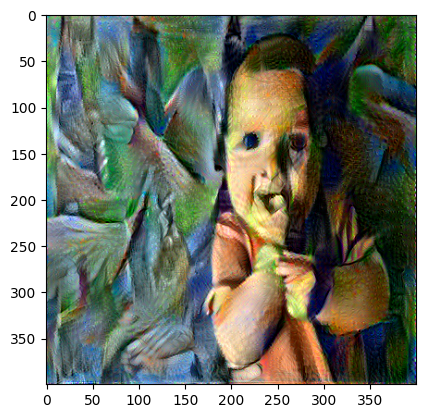

Epoch 17500 


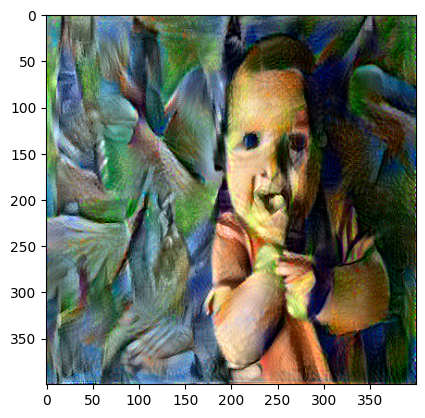

Epoch 18000 


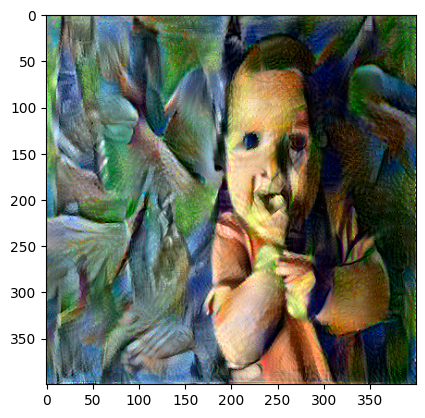

Epoch 18500 


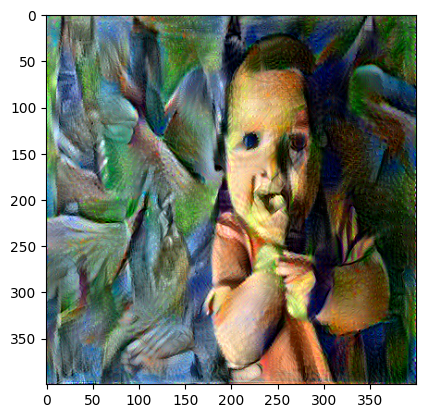

Epoch 19000 


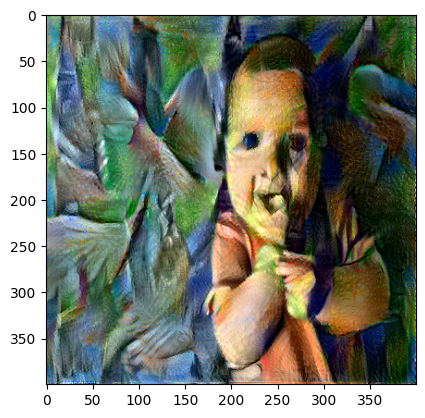

Epoch 19500 


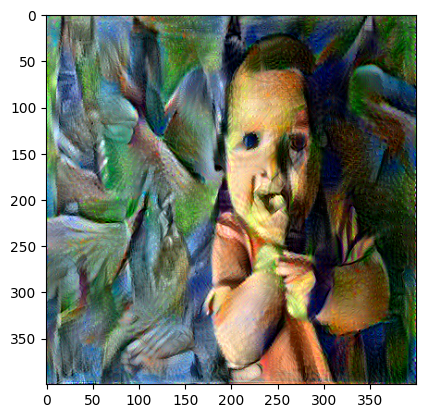

Epoch 20000 


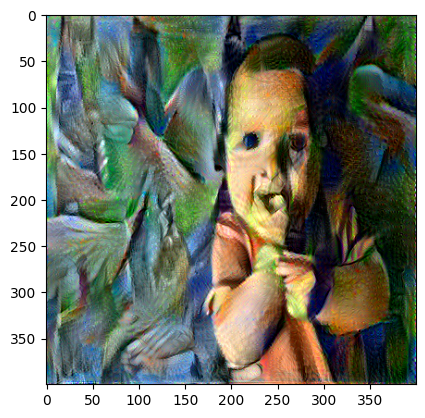

In [ ]:
# Showing the generated image at some epochs
epochs = 20001
for i in range(epochs):
    train_step(generated_image)
    if i % 500 == 0:
        print(f"Epoch {i} ")
        image = tensor_to_image(generated_image)
        imshow(image)
        plt.show()

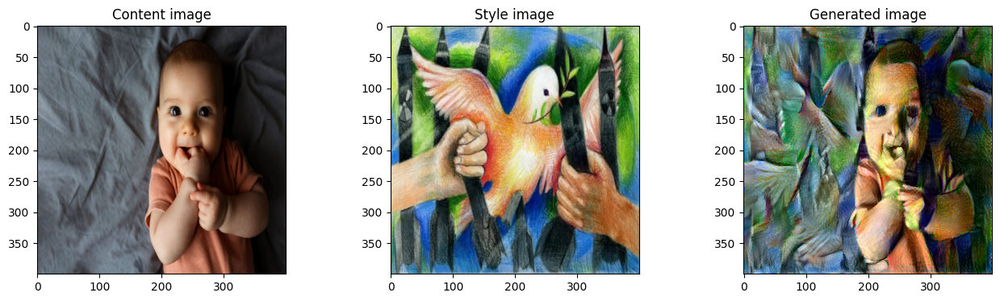

In [ ]:
# Show the 3 images in a row
fig = plt.figure(figsize=(16, 4))
ax = fig.add_subplot(1, 3, 1)
imshow(content_image[0])
ax.title.set_text('Content image')
ax = fig.add_subplot(1, 3, 2)
imshow(style_image[0])
ax.title.set_text('Style image')
ax = fig.add_subplot(1, 3, 3)
imshow(generated_image[0])
ax.title.set_text('Generated image')
plt.show()

**Quantitative evaluation of style transfer**
* Reference- Zhizhong Wang, Lei Zhao, Haibo Chen, Zhiwen Zuo, Ailin Li, Wei Xing, Dongming Lu, **Evaluate and improve the quality of neural style transfer,
Computer Vision and Image Understanding**,
Volume 207,
2021,
103203,
ISSN 1077-3142,
https://doi.org/10.1016/j.cviu.2021.103203.

**Content fidelity** (CF) -factor to measure the faithfulness to content characteristics in multiple scales.

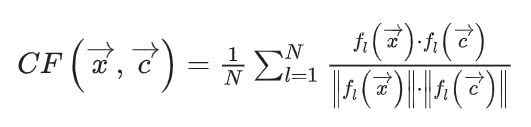

 **Global Effects (GE)**- When comparing the transferred style with the style image, people often appreciate the global effects first. The global similarity will leave a preliminary impression on humans’ visual perception, so it is an important factor for measuring the stylization quality.global effect (GE) factor also includes these two aspects, namely, global colors (GC) and holistic textures (HT).

**Limitations**- The Model can be made more robust in terms of varying the hperparameters. A cascade of NST can be implemented by changing hyperparameters like alpha, beta, number of epochs, learning rate, and out of multiple model outputs the best generated image can be chosen.

**References**-
* Coursera Deep Learning Specialization- Convolution Neural Networks
* Leon A. Gatys, Alexander S. Ecker, Matthias Bethge, (2015). A Neural Algorithm of Artistic Style.
* Neural Style Transfer, Tensorflow. https://www.tensorflow.org/tutorials/generative/style_transfer